# Demo for paper "First Order Motion Model for Image Animation"

**Clone repository**

In [1]:
#from google.colab import drive
#drive.mount('/content/gdrive')

**content located https://drive.google.com/drive/folders/1kZ1gCnpfU0BnpdU47pLM_TQ6RypDDqgw?usp=sharing  to your google drive.**

In [2]:
import skimage
print(skimage.__version__) #0.17.2

0.13.1


In [3]:
#!pip install -U scikit-image

In [4]:
#!pip install nvidia-ml-py3

**Load driving video and source image**

In [5]:
import torch
print(torch.__version__) # 1.0.0 required for training?

1.4.0


In [6]:
!pwd

/home/ec2-user/SageMaker/Banzai-livingPortrait/first-order-model


In [7]:
import imageio
import numpy as np
#plt.rcParams['animation.ffmpeg_path'] = '../../../anaconda3/lib/python3.6/site-packages/imageio/plugins/ffmpeg.py'
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from skimage.transform import resize
from IPython.display import HTML
import warnings

warnings.filterwarnings("ignore")

source_image = imageio.imread('./images/Mona.png')
driving_video = imageio.mimread('./videos/praatjeLuther.mp4',memtest=False)


#Resize image and video to 256x256

source_image = resize(source_image, (256, 256))[..., :3]
driving_video = [resize(frame, (256, 256))[..., :3] for frame in driving_video]

def display(source, driving, generated=None):
    fig = plt.figure(figsize=(8 + 4 * (generated is not None), 6))

    ims = []
    for i in range(len(driving)):
        cols = [source]
        cols.append(driving[i])
        if generated is not None:
            cols.append(generated[i])
        im = plt.imshow(np.concatenate(cols, axis=1), animated=True)
        plt.axis('off')
        ims.append([im])

    ani = animation.ArtistAnimation(fig, ims, interval=50, repeat_delay=1000)
    plt.close()
    return ani
    

HTML(display(source_image, driving_video).to_html5_video())

OSError: Could not load meta information
=== stderr ===

ffmpeg version 4.2.3 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7.5.0 (crosstool-NG 1.24.0.123_1667d2b)
  configuration: --prefix=/home/ec2-user/anaconda3/envs/JupyterSystemEnv --cc=/home/conda/feedstock_root/build_artifacts/ffmpeg_1590573566052/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --disable-openssl --enable-avresample --enable-gnutls --enable-gpl --enable-hardcoded-tables --enable-libfreetype --enable-libopenh264 --enable-libx264 --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100
  libavdevice    58.  8.100 / 58.  8.100
  libavfilter     7. 57.100 /  7. 57.100
  libavresample   4.  0.  0 /  4.  0.  0
  libswscale      5.  5.100 /  5.  5.100
  libswresample   3.  5.100 /  3.  5.100
  libpostproc    55.  5.100 / 55.  5.100
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x55960fe0acc0] Format mov,mp4,m4a,3gp,3g2,mj2 detected only with low score of 1, misdetection possible!
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x55960fe0acc0] moov atom not found
/home/ec2-user/SageMaker/Banzai-livingPortrait/first-order-model/videos/praatjeLuther.mp4: Invalid data found when processing input

**Create a model and load checkpoints**

In [ ]:
from demo import load_checkpoints
generator, kp_detector = load_checkpoints(config_path='config/vox-256.yaml', 
                            checkpoint_path='./models/vox-cpk.pth.tar')

**Perform image animation**

In [ ]:
from demo import make_animation
from skimage import img_as_ubyte

In [10]:
predictions = make_animation(source_image, driving_video, generator, kp_detector, relative=True)

#save resulting video
#imageio.mimsave('./output/generated.mp4', [img_as_ubyte(frame) for frame in predictions])
#video can be downloaded from /content folder

HTML(display(source_image, driving_video, predictions).to_html5_video())

NameError: name 'driving_video' is not defined

## Import and reload source image and video of Japsert

And resize to frames of 256x256.

In [12]:
!python cropvideo.py --inp /home/ec2-user/SageMaker/Banzai-livingPortrait/first-order-model/videos/Filmpje5.mp4

858it [02:38,  5.39it/s]Traceback (most recent call last):
  File "/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/imageio/plugins/ffmpeg.py", line 565, in _read_frame_data
    (len(s), framesize))
RuntimeError: Frame is 0 bytes, but expected 5482080.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "cropvideo.py", line 156, in <module>
    commands = process_video(args)
  File "cropvideo.py", line 96, in process_video
    for i, frame in tqdm(enumerate(video)):
  File "/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/tqdm/std.py", line 1107, in __iter__
    for obj in iterable:
  File "/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/imageio/core/format.py", line 397, in iter_data
    im, meta = self._get_data(i)
  File "/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/imageio/plugins/ffmpeg.py", line 396, in _get_data
    result, is_new =

In [17]:
!ffmpeg -i /home/ec2-user/SageMaker/Banzai-livingPortrait/first-order-model/videos/Coen.mp4 -ss 0.0 -t 9.4 -filter:v "crop=938:938:96:614, scale=256:256" /home/ec2-user/SageMaker/Banzai-livingPortrait/first-order-model/videos/cropCoen.mp4
    
    
    

ffmpeg version 4.2.3 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7.5.0 (crosstool-NG 1.24.0.123_1667d2b)
  configuration: --prefix=/home/ec2-user/anaconda3/envs/JupyterSystemEnv --cc=/home/conda/feedstock_root/build_artifacts/ffmpeg_1590573566052/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --disable-openssl --enable-avresample --enable-gnutls --enable-gpl --enable-hardcoded-tables --enable-libfreetype --enable-libopenh264 --enable-libx264 --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100
  libavdevice    58.  8.100 / 58.  8.100
  libavfilter     7. 57.100 /  7. 57.100
  libavresample   4.  0.  0 /  4.  0.  0
  libswscale      5.  5.100 /  5.  5.100
  libswresample   3.  5.100 /  3.  5.100
  libpostproc    55.  5.100 / 55.  5.100
Input #0, mov,mp4,m4a,3gp,3g2,mj2, fro

In [10]:
pwd

'/home/ec2-user/SageMaker/Banzai-livingPortrait/first-order-model'

In [8]:
!python demo.py --config config/vox-adv-256.yaml --driving_video videos/luther10.mp4 --source_image images/LutherHimself.png --checkpoint models/vox-adv-cpk.pth.tar --relative --adapt_scale

/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/imageio/core/format.py:403: UserWarning: Could not read last frame of /home/ec2-user/SageMaker/Banzai-livingPortrait/first-order-model/videos/luther10.mp4.
  warn('Could not read last frame of %s.' % uri)
/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
demo.py:27: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  config = yaml.load(f)
  0%|                                                   | 0/623 [00:00<?, ?it/s]/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/torch/nn/functional.py:2705: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corner

In [14]:
!python demo.py --config config/vox-adv-256.yaml --driving_video videos/Filmpje7.mp4 --source_image images/vrouwLuther2.png --checkpoint models/vox-adv-cpk.pth.tar --relative --adapt_scale



demo.py:27: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  config = yaml.load(f)
  0%|                                                   | 0/844 [00:00<?, ?it/s]/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/torch/nn/functional.py:2705: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn("Default grid_sample and affine_grid behavior has changed "
/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/torch/nn/functional.py:2506: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "

In [41]:
from demo import load_checkpoints
generator, kp_detector = load_checkpoints(config_path='config/vox-256.yaml', 
                            checkpoint_path='./models/vox-cpk.pth.tar')

In [42]:
from demo import make_animation
from skimage import img_as_ubyte

In [10]:
source_image_luther = imageio.imread('./images/Mona.png')
driving_video = imageio.mimread('./videos/trump.mp4')

In [11]:
source_image = resize(source_image, (256, 256))[..., :3]
driving_video = [resize(frame, (256, 256))[..., :3] for frame in driving_video]

In [12]:
predictions_luther = make_animation(source_image_luther, driving_video, generator, kp_detector, relative=True)

RuntimeError: Given groups=3, weight of size 3 1 13 13, expected input[1, 4, 288, 288] to have 3 channels, but got 4 channels instead

In [26]:
HTML(display(source_image_luther, driving_video, predictions_luther).to_html5_video())

NameError: name 'predictions_luther' is not defined

In [8]:
source_image_katherina = imageio.imread('./images/vrouwLuther.jpg')
source_image_luther = imageio.imread('./images/test_cropped.jpg')
driving_video = imageio.mimread('./videos/Jasper.MOV', memtest=False)

#Resize image and video to 256x256
source_image_katherina = resize(source_image_katherina, (256, 256))[..., :3]
source_image_luther = resize(source_image_luther, (256, 256))[..., :3]

driving_video = [resize(frame, (256, 256))[..., :3] for frame in driving_video]

In [9]:
# make initial predictions 

predictions_katherina = make_animation(source_image_katherina, driving_video, generator, kp_detector, relative=True)
predictions_luther = make_animation(source_image_luther, driving_video, generator, kp_detector, relative=True)

100%|██████████| 540/540 [00:11<00:00, 45.66it/s]


In [25]:
HTML(display(source_image_katherina, driving_video, predictions_katherina).to_html5_video())

In [10]:
HTML(display(source_image_luther, driving_video, predictions_luther).to_html5_video())

In [11]:
predictions_luther = make_animation(source_image_luther, driving_video, generator, kp_detector, relative=False)

100%|██████████| 540/540 [00:11<00:00, 48.10it/s]


In [12]:
HTML(display(source_image_luther, driving_video, predictions_luther).to_html5_video())

--------------

## Inherited key-points from Jasper's demo face

**In the cell above we use relative keypoint displacement to animate the objects. We can use absolute coordinates instead,  but in this way all the object proporions will be inherited from the driving video. For example Putin haircut will be extended to match Trump haircut.**

In [29]:
predictions_kat_kp = make_animation(source_image_katherina, driving_video, generator, kp_detector, relative=False, adapt_movement_scale=True)
predictions_luth_kp = make_animation(source_image_luther, driving_video, generator, kp_detector, relative=False, adapt_movement_scale=True)


100%|██████████| 540/540 [00:10<00:00, 49.27it/s]


In [30]:
HTML(display(source_image_katherina, driving_video, predictions_kat_kp).to_html5_video())

In [31]:
HTML(display(source_image_luther, driving_video, predictions_luth_kp).to_html5_video())


## Tryout met Coens hoofd

In [10]:
driving_video_coen = imageio.mimread('./videos/VID20200529223339.mp4', memtest=False)

In [11]:
driving_video_coen = [resize(frame, (256, 256))[..., :3] for frame in driving_video_coen]

predictions_luth_kp_coen = make_animation(source_image_luther, driving_video_coen, generator, kp_detector, relative=False, adapt_movement_scale=True)


100%|██████████| 283/283 [00:05<00:00, 47.80it/s]


In [12]:
HTML(display(source_image_luther, driving_video_coen, predictions_luth_kp_coen).to_html5_video())


In [13]:
# Hoofd resizen: re-import movie: 
driving_video_coen = imageio.mimread('./videos/VID20200529223339.mp4', memtest=False)

Populating the interactive namespace from numpy and matplotlib
(1920, 1080, 3)
(1000, 1000, 3)


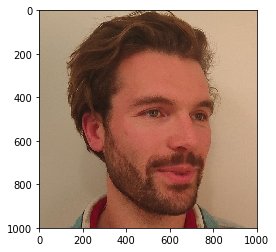

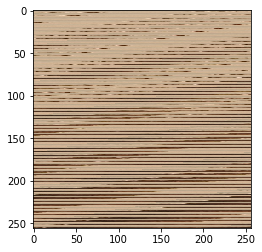

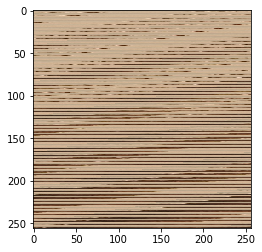

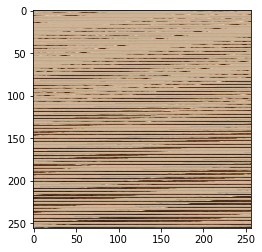

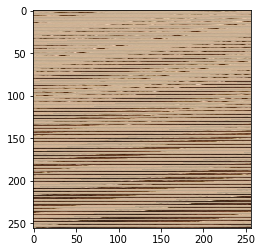

...

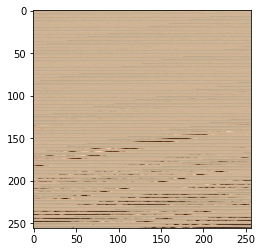

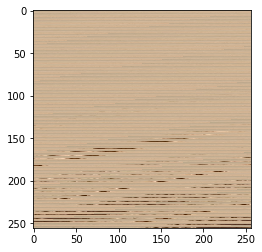

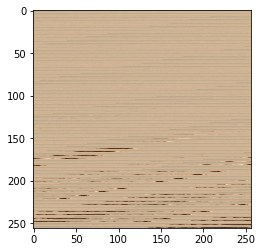

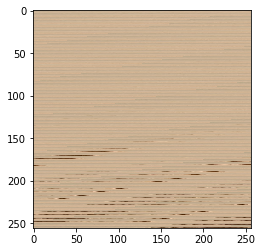

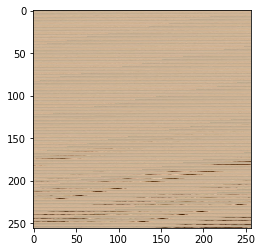

KeyboardInterrupt: 

In [26]:
%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img=driving_video_coen[0]
print(img.shape)
img = img[500:1500,0:1000,:]
print(img.shape)

# imgplot = plt.imshow(img)
plt.show(plt.imshow(img)) 

# driving_video_coen2 = [resize(frame[500:1500,0:1000,:],(256, 256))[..., :3] for frame[...,:3] in driving_video_coen]
driving_video_coen2 = [plt.show(plt.imshow(resize(frame[500:1500,0:1000,:],(256, 256,3)))) for frame in driving_video_coen]

# print(driving_video_coen2[0].shape)

In [20]:
predictions_luth_kp_coen = make_animation(source_image_luther, driving_video_coen2, generator, kp_detector, relative=False, adapt_movement_scale=True)

RuntimeError: number of dims don't match in permute

In [4]:
!ffmpeg -i ./videos/Coen.mp4 -ss 0.0 -t 9.433333333333334 -filter:v "crop=938:938:96:614, scale=256:256" crop.mp4

/bin/sh: ffmpeg: command not found


In [16]:
import sys
import os
sys.path.append('/home/ec2-user/anaconda3/envs/JupyterSystemEnv/lib/python3.6/site-packages')

## Running on your data --> Samesame als boven toch?

**First we need to crop a face from both source image and video, while simple graphic editor like paint can be used for cropping from image. Cropping from video is more complicated. You can use ffpmeg for this.**

In [ ]:
!ffmpeg -i /content/gdrive/My\ Drive/first-order-motion-model/07.mkv -ss 00:08:57.50 -t 00:00:08 -filter:v "crop=600:600:760:50" -async 1 hinton.mp4

ffmpeg version 3.4.6-0ubuntu0.18.04.1 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.3.0-16ubuntu3)
  configuration: --prefix=/usr --extra-version=0ubuntu0.18.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --ena

**Another posibility is to use some screen recording tool, or if you need to crop many images at ones use face detector(https://github.com/1adrianb/face-alignment) , see https://github.com/AliaksandrSiarohin/video-preprocessing for preprcessing of VoxCeleb.** 

In [ ]:
source_image = imageio.imread('/content/gdrive/My Drive/first-order-motion-model/09.png')
driving_video = imageio.mimread('hinton.mp4', memtest=False)


#Resize image and video to 256x256

source_image = resize(source_image, (256, 256))[..., :3]
driving_video = [resize(frame, (256, 256))[..., :3] for frame in driving_video]

predictions = make_animation(source_image, driving_video, generator, kp_detector, relative=True,
                             adapt_movement_scale=True)

HTML(display(source_image, driving_video, predictions).to_html5_video())

100%|██████████| 240/240 [00:08<00:00, 29.00it/s]
